In [1]:
from scapy.all import rdpcap
from pydub import AudioSegment
from IPython.display import HTML, Audio
import matplotlib.pyplot as plt
import librosa.display as ld
import librosa
import wave
import pandas as pd
import numpy as np
import os



# Defina o caminho para o executável do TShark
os.environ['TSHARK_PATH'] = '/usr/bin/tshark'


/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/.venv/lib/python3.12/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [2]:
# Uso da função
PATH = '/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/'
pcap_path = PATH + 'src/Dataset/Benignos/sine/freq100-1000.pcapng'

In [3]:
fname = '/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/src/scripts/reconstructed_audio.wav'
data, sample_rate = librosa.load(fname, sr=48000)


In [4]:
Audio(data=data, rate=sample_rate)


In [5]:
import plotly.graph_objects as go
import librosa

# Criar o gráfico
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=np.arange(len(data)) / sample_rate,
    y=data,
    mode='lines',
    name='Amplitude'
))

fig.update_layout(
    title='Waveform do Áudio',
    xaxis_title='Tempo (segundos)',
    yaxis_title='Amplitude'
)

fig.show()


In [56]:
import pandas as pd
import matplotlib.pyplot as plt
from scapy.all import rdpcap, Raw

def read_pcapng(file_path):
    packets = rdpcap(file_path)
    data_packets = []
    
    for packet in packets:
        if Raw in packet:
            time = packet.time
            payload = packet[Raw].load  # Extrair payload
            data_packets.append((time, payload))
    
    return data_packets

def create_dataframe(packets):    
    data = {
        'time': [pkt[0] for pkt in packets],
        'payload': [(np.frombuffer(pkt[1], dtype='<i2') / np.max(np.abs(np.frombuffer(pkt[1], dtype='<i2')))) for pkt in packets]
    }
    df = pd.DataFrame(data)
    return df


def reconstruct_audio(packets, output_file, sample_rate = 44100,
                        num_channels = 1, sample_width = 2):
    
    # audio is in PCM format with 16-bit samples
    with wave.open(output_file, 'wb') as wf:
        wf.setnchannels(num_channels)
        wf.setsampwidth(sample_width)
        wf.setframerate(sample_rate)
        
        for _, payload in packets:
            wf.writeframes(payload)
    print(f'reconstruct_audio in {output_file}')
    

def plot_waveform(df):
    plt.figure(figsize=(12, 6))
    plt.plot(df['time'], df['payload'], label='Waveform')
    
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Waveform of the Audio Signal')
    plt.legend()
    plt.show()



In [57]:
output_audio_file = 'reconstructed_audio.wav'
reconstruct_audio(packets, output_audio_file)


reconstruct_audio in reconstructed_audio.wav


In [19]:
# Read the pcapng file and extract packets
packets = read_pcapng(pcap_path)


In [49]:
# Create a dataframe
df = create_dataframe(packets)


In [50]:
df

,time,payload
0,1520610980.237519543,"[-1.0, 0.0014149492463857276, 0.0, 0.0, 0.0, 0..."
1,1520610980.237644566,"[-1.0, 0.0014457090126115042, 0.0, 0.0, 0.0, 0..."
2,1520610980.237769542,"[-0.9948893717293509, 0.0014689230957554242, 0..."
3,1520610980.237894541,"[-0.9923081618948782, 0.0014956351871070143, 0..."
4,1520610980.238019565,"[-1.0, 0.0015379883112888342, 0.0, 0.0, 0.0, 0..."
...,...,...
485861,1520611040.683688622,"[-1.0, 0.0009843125192248539, 0.0, 0.0, 0.0, 0..."
485862,1520611040.683813606,"[-1.0, 0.0010150722854506305, 0.0, 0.0, 0.0, 0..."
485863,1520611040.683938621,"[-1.0, 0.0010458320516764073, 0.0, 0.0, 0.0, 0..."
485864,1520611040.684063621,"[-1.0, 0.001076591817902184, 0.0, 0.0, 0.0, 0...."


ValueError: setting an array element with a sequence.

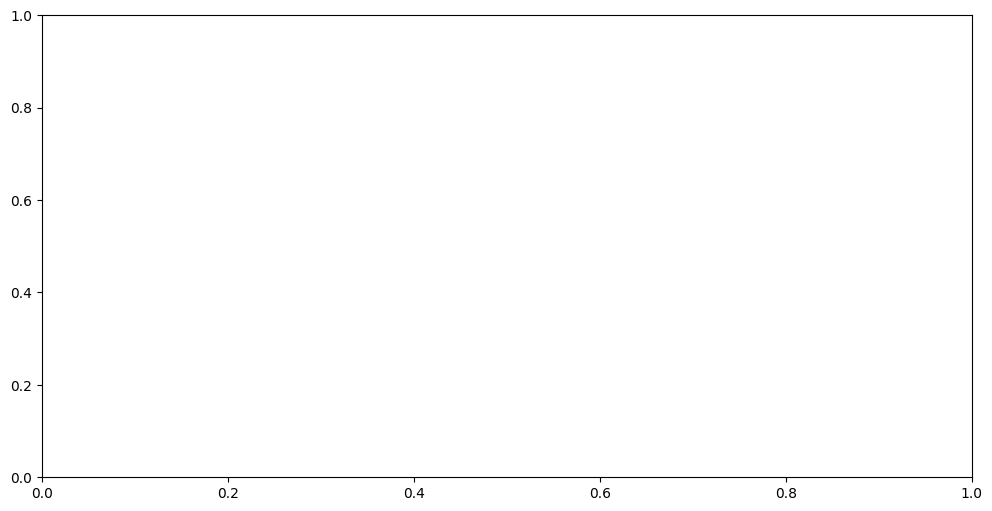

In [51]:
# Plot the waveform
plot_waveform(df)
